In [1]:
import csv
import networkx as nx
import numpy as np
import math
import pandas as pd
import holoviews as hv
from holoviews.operation.datashader import datashade, bundle_graph
from networkx.algorithms import community
import pygraphviz
from networkx.drawing.nx_agraph import graphviz_layout
from networkx.drawing.nx_agraph import to_agraph 
from collections import Counter
from itertools import combinations, permutations

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)
warnings.simplefilter('ignore')

/Users/moses/opt/anaconda3/lib/python3.7/site-packages/dask/dataframe/utils.py:13: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
datafile = 'SCOPUS Disease Control through Social Network Surveillance.csv' 
name = "Disease Control through Social Network Surveillance"
st = "Scopus bibliometric dataset on %s" %name

## 1. The Citation Network

In [3]:
node_list = [] # a list of titles and references
edge_list = [] # includes rows of format [a, b] where 'a' references 'b'
type_dict = {} # key: node, value: type ('title' or 'reference'), holds all possible node values

''' 
Requires: 'n_type' is either 'title' or 'reference' 
Modifies: If 'node' occurs in the list, preserves type 'title,' changing either 
          the 'node_list' value and the 'type_dict' type, or just the 'node' value.
          Else, adds 'node' to 'node_list.'
Effects:  Compares 'node' to the current 'note_list.' 
'''
def comp_add(node_list, node, n_type):
    for i in range(len(node_list)): 
        # check to see if 'node' compares to any current nodes
        if node in node_list[i] or node_list[i] in node: 
            # if a node exists as a row 'title' and a row 'reference', 
            # we want to favor the type 'title' in our data structures 
            if n_type == 'title': 
                # switch the representation in 'node_list' to 'title'
                node_list[i] = node
                type_dict[node] = n_type 
            else:
                # switch the representation of 'node' to 'title' 
                node = node_list[i]
            return node 
        
    # The rest of this function executes if 'node' is not already in 'node_list'
    if n_type == 'title':
        node_list.append(node)
        type_dict[node] = n_type
    else: 
        node_list.append(node)
        type_dict[node] = n_type

    return node

In [4]:
''' 
Main loop to parse data into nodes and edges. It takes a lot of time to run!
'''
cnt = 0
rows = 0
with open(datafile) as csv_file:
    reader = csv.DictReader(csv_file)
    for row in reader:
        rows += 1
        # Add node with unique identifier
        source_node = row['Title']
        source_node = comp_add(node_list, source_node, 'title')
        # Add an edge for each source and its references
        # Some rows may not any references. to check, verify 'refs' is a string
        if type(row['References']) != '':  
            cnt += 1
            refs = row['References'].split(';')
            for ref in refs:
                # Disregard web references, and clean data for any formatting inconsistencies
                if 'https://' not in ref and 'http://' not in ref and ref != " " and ref != "":  
                    ref = comp_add(node_list, ref, 'reference')
                    edge = [source_node, ref] # 'source_node' references 'ref'
                    edge_list.append(edge)

In [5]:
G = nx.DiGraph()
for n in node_list: 
    G.add_node(n)
G.add_edges_from(edge_list)

In [6]:
# First remove nodes of degree 1
nodes_to_remove = []
for n in G.nodes(): 
    if G.degree(n) == 1: 
        nodes_to_remove.append(n)
G.remove_nodes_from(nodes_to_remove)

# Then remove nodes that are isolated 
nodes_to_remove = []
for n in G.nodes(): 
    if G.degree(n) == 0: 
        nodes_to_remove.append(n)
G.remove_nodes_from(nodes_to_remove)

In [7]:
def g_diagnostics(G,st):
    print("The %s has %i nodes and %i edges" %(st,len(G.nodes()), len(G.edges())),'\n')
    if G.is_directed()==True:
        print("The %s is a directed graph" %st)
    else:
        print("The %s is an undirected graph" %st) 
    if G.is_multigraph()==True:
        print("The %s is a multigraph" %st)
    else:
        print("The %s is a simple graph" %st)
    if nx.is_weighted(G)==True:
        print("The %s is a weighted graph" %st)
    else:
        print("The %s is an unweighted graph" %st) 
    if nx.is_bipartite(G)==True:
        print("The %s is a bipartite graph" %st)
    else:
        print("The %s is not a bipartite graph" %st)    
    if nx.is_tree(G)==True:
        print("The %s is a tree \n" %st)
    else:
        print("The %s is not a tree \n" %st )   
    if G.is_directed()==False:
        if nx.is_connected(G)==True:
            print("The %s is a connected graph" %st)
        else:
            print("The %s is a disconnected graph and it has %i connected components" %(st,nx.number_connected_components(G)))   
            giant = max(nx.connected_components(G), key=len)
            Glcc=G.subgraph(giant)
            print("The largest connected component of this graph has %i nodes and %i edges" %(len(Glcc.nodes()),len(Glcc.edges())))
    else:
        if nx.is_strongly_connected(G)==True:
            print("The %s is a strongly connected graph" %st)
        else:
            print("The %s is not strongly connected and it has %i strongly connected components" %(st,nx.number_strongly_connected_components(G)))
            giant = max(nx.strongly_connected_components(G), key=len)
            Glcc=G.subgraph(giant)
            print("The largest strongly connected component of this graph has %i nodes and %i edges" %(len(Glcc.nodes()),len(Glcc.edges())))
        if nx.is_weakly_connected(G)==True:
            print("The %s is a weakly connected graph" %st)
        else:
            print("The %s is not weakly connected and it has %i weakly connected components" %(st,nx.number_weakly_connected_components(G)))
    if len(list(nx.isolates(G)))>0:
        print("The %s has %i isolates \n" %(st,len(list(nx.isolates(G)))))
    else:
        print("The %s has no isolates \n" %st)
    print("The density of the %s is %.3f" %(st,nx.density(G)))  
    try:
        print("The transitivity of the %s is %.3f" %(st,nx.transitivity(G)) )
    except Exception as e: 
        print("Transitivity not computable: "+str(e))
    if G.is_directed()==True:
        print("The reciprocity of the %s is %.3f" %(st,nx.reciprocity(G)))
    if G.is_directed()==False:
        try:
            print("The average clustering of the %s is %.3f" %(st,nx.algorithms.cluster.average_clustering(G)))
        except Exception as e: 
            print("Average clustering not computable: "+str(e))
        if nx.is_connected(G)==True:
            print("The average shortest path length of the %s is %.3f" %(st,nx.algorithms.shortest_paths.generic.average_shortest_path_length(G)))  
    try:
        diameter=nx.diameter(G)
        print("The diameter of the %s is %i" %(st,diameter))
    except Exception as e: 
        print("Diameter not computable: "+str(e))

In [8]:
g_diagnostics(G,st)

The Scopus bibliometric dataset on Disease Control through Social Network Surveillance has 951 nodes and 1752 edges 

The Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a directed graph
The Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a simple graph
The Scopus bibliometric dataset on Disease Control through Social Network Surveillance is an unweighted graph
The Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not a bipartite graph
The Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not a tree 

The Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not strongly connected and it has 951 strongly connected components
The largest strongly connected component of this graph has 1 nodes and 0 edges
The Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not weakly connect

### 1a. Communities of the citation network

In [9]:
for n in G.nodes:
    G.nodes[n]['label'] = type_dict[n]
    G.nodes[n]['in-degree'] = G.in_degree(n)

In [10]:
communities_generator = community.girvan_newman(G)
communities = next(communities_generator)

# Sort the communities based on size 
groups = []
for c in communities: 
    size = len(c)
    groups.append([size, list(c)])
groups.sort(reverse=True)
print("The %s graph has %i Girvan-Newman communities" %(st,len(groups)))

# Give each node a community id to which it belongs 
# Groups with a lower 'group_id' will be a member of a larger group
commsd={}
group_id = 1
for group in groups:
    members = group[1]
    for n in members: 
        G.nodes[n]['community'] = group_id
    group_id += 1
    commsd["Community_"+str(group_id-1)]=group[0]

ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
sst="Bar plot of the membership size of Girvan-Newman communities of the \n citation graph of the %s" %st
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(12,7),rot=90,title=sst);

The Scopus bibliometric dataset on Disease Control through Social Network Surveillance graph has 34 Girvan-Newman communities


### 1b. Interactive visualization of the citation network

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
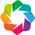

In [11]:
hv.extension('bokeh')
kwargs = dict(width=1000, height=1000, xaxis=None, yaxis=None)
hv.opts.defaults(hv.opts.Nodes(**kwargs), hv.opts.Graph(**kwargs)) 

# Choose a NetworkX graphical layout 
pos = graphviz_layout(G) 
# Collect graph from NetworkX 
my_graph = hv.Graph.from_networkx(G, pos)
# Bundle edges 
bundled = bundle_graph(my_graph)
bundled.opts(padding=0.1) 
# Add community and in-degree features
bundled.opts(node_color=hv.dim('community'), node_size=((hv.dim('in-degree') + 10)*0.6), width=1000, cmap='Colorblind')
bundled.opts(inspection_policy='edges')

# Save the visualization as html
hv.save(bundled, 'CitationGraph.html', backend='bokeh')

from bokeh.plotting import show 
show(hv.render(bundled))

### 1c. The largest weakly connected component of the citation graph

In [13]:
st1="largest weakly connected component of the citation graph of the %s" %st
giant = max(nx.weakly_connected_components(G), key=len)
Glwcc=G.subgraph(giant)
g_diagnostics(Glwcc,st1)

The largest weakly connected component of the citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance has 800 nodes and 1608 edges 

The largest weakly connected component of the citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a directed graph
The largest weakly connected component of the citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a simple graph
The largest weakly connected component of the citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is an unweighted graph
The largest weakly connected component of the citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not a bipartite graph
The largest weakly connected component of the citation graph of the Scopus bibliometric dataset on Disease Control through Socia

### 1d. Communities of the largest weakly connected component of the citation graph

In [14]:
for n in Glwcc.nodes:
    Glwcc.nodes[n]['label'] = type_dict[n]
    Glwcc.nodes[n]['in-degree'] = Glwcc.in_degree(n)

The largest weakly connected component of the citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance graph has 2 Girvan-Newman communities


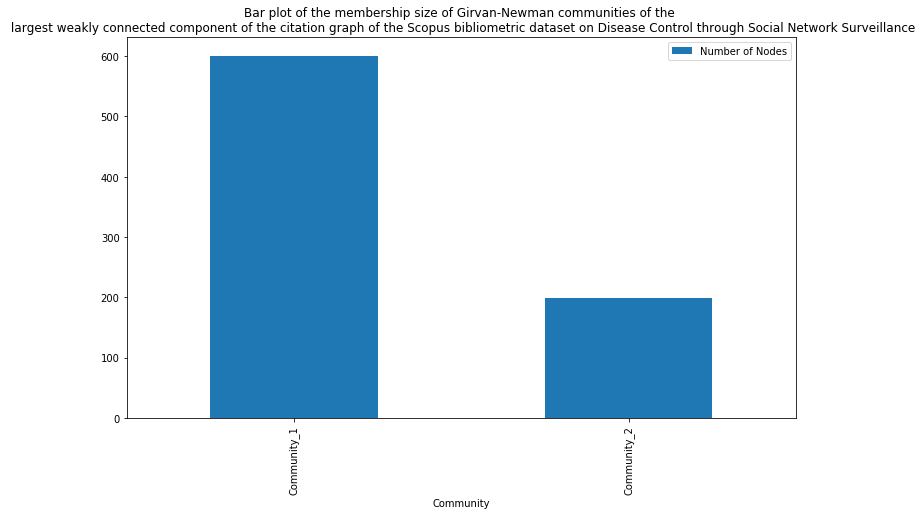

In [15]:
communities_generator = community.girvan_newman(Glwcc)
communities = next(communities_generator)

# Sort the communities based on size 
groups = []
for c in communities: 
    size = len(c)
    groups.append([size, list(c)])
groups.sort(reverse=True)
print("The %s graph has %i Girvan-Newman communities" %(st1,len(groups)))

# Give each node a community id to which it belongs 
# Groups with a lower 'group_id' will be a member of a larger group
commsd={}
group_id = 1
for group in groups:
    members = group[1]
    for n in members: 
        Glwcc.nodes[n]['community'] = group_id
    group_id += 1
    commsd["Community_"+str(group_id-1)]=group[0]
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
sst="Bar plot of the membership size of Girvan-Newman communities of the \n %s" %st1
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(12,7),rot=90,title=sst);

### 1e. Interactive visualization of the largest weakly connected component of the citation graph

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
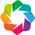

In [16]:
hv.extension('bokeh')
kwargs = dict(width=1000, height=1000, xaxis=None, yaxis=None)
hv.opts.defaults(hv.opts.Nodes(**kwargs), hv.opts.Graph(**kwargs)) 

# Choose a NetworkX graphical layout 
pos = graphviz_layout(Glwcc) 
# Collect graph from NetworkX 
my_graph = hv.Graph.from_networkx(Glwcc, pos)
# Bundle edges 
bundled = bundle_graph(my_graph)
bundled.opts(padding=0.1) 
# Add community and in-degree features
bundled.opts(node_color=hv.dim('community'), node_size=((hv.dim('in-degree') + 10)*0.6), width=1000, cmap='Colorblind')
bundled.opts(inspection_policy='edges')

# Save the visualization as html
hv.save(bundled, 'LWCC_CitationGraph.html', backend='bokeh')

from bokeh.plotting import show 
show(hv.render(bundled))

## 2. The Co-Citation Network

In [17]:
G1=G.copy()
medgesout=[]
n_out=[n for n in G1.nodes() if G1.out_degree(n)>1]
for n in n_out:
    nn=list(G1.successors(n))
    combs=combinations(nn, 2)
    for j in combs:
        medgesout.append((j[0],j[1]))
Gcocitation=nx.MultiGraph()
Gcocitation.add_edges_from(medgesout)
weight=[(x, y, {'weight': v}) for (x, y), v in Counter(Gcocitation.edges()).items()]
Gcocitation = nx.Graph(weight)
edge_width=[Gcocitation[u][v]['weight'] for u,v in Gcocitation.edges()]

st2="co-citation network of the %s" %st
g_diagnostics(Gcocitation,st2)

The co-citation network of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance has 603 nodes and 7520 edges 

The co-citation network of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is an undirected graph
The co-citation network of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a simple graph
The co-citation network of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a weighted graph
The co-citation network of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not a bipartite graph
The co-citation network of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not a tree 

The co-citation network of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a disconnected graph and it has 21 connected components
The larges

### 2a. Communities of the co-citation network

In [18]:
for n in Gcocitation.nodes:
    Gcocitation.nodes[n]['label'] = type_dict[n]
    Gcocitation.nodes[n]['degree'] = Gcocitation.degree(n)

The co-citation network of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance graph has 22 Girvan-Newman communities


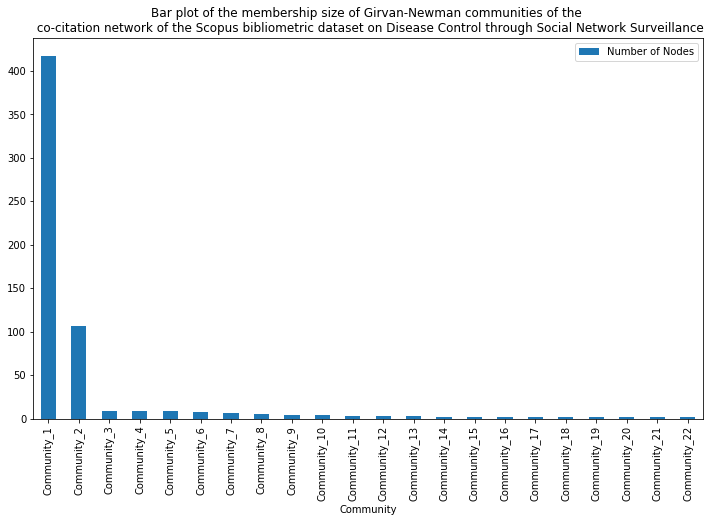

In [19]:
communities_generator = community.girvan_newman(Gcocitation)
communities = next(communities_generator)

# Sort the communities based on size 
groups = []
for c in communities: 
    size = len(c)
    groups.append([size, list(c)])
groups.sort(reverse=True)
print("The %s graph has %i Girvan-Newman communities" %(st2,len(groups)))

# Give each node a community id to which it belongs 
# Groups with a lower 'group_id' will be a member of a larger group
commsd={}
group_id = 1
for group in groups:
    members = group[1]
    for n in members: 
        Gcocitation.nodes[n]['community'] = group_id
    group_id += 1
    commsd["Community_"+str(group_id-1)]=group[0]
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
sst="Bar plot of the membership size of Girvan-Newman communities of the \n %s" %st2
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(12,7),rot=90,title=sst);

### 2b. Interactive visualization of the co-citation network

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
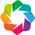

In [20]:
hv.extension('bokeh')
kwargs = dict(width=1000, height=1000, xaxis=None, yaxis=None)
hv.opts.defaults(hv.opts.Nodes(**kwargs), hv.opts.Graph(**kwargs)) 

# Choose a NetworkX graphical layout 
pos = graphviz_layout(Gcocitation) 
# Collect graph from NetworkX 
my_graph = hv.Graph.from_networkx(Gcocitation, pos)
# Bundle edges 
bundled = bundle_graph(my_graph)
bundled.opts(padding=0.1) 
# Add community and degree features
bundled.opts(node_color=hv.dim('community'), node_size=((hv.dim('degree') + 50)*0.1), width=1000, cmap='Colorblind')
bundled.opts(inspection_policy='edges')

# Save the visualization as html
hv.save(bundled, 'CoCitationGraph.html', backend='bokeh')

from bokeh.plotting import show 
show(hv.render(bundled))

### 2c. The largest connected component of the co-citation graph

In [22]:
st3="largest connected component of the co-citation graph of the %s" %st
giant = max(nx.connected_components(Gcocitation), key=len)
Glcc=Gcocitation.subgraph(giant)
g_diagnostics(Glcc,st3)

The largest connected component of the co-citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance has 523 nodes and 7386 edges 

The largest connected component of the co-citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is an undirected graph
The largest connected component of the co-citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a simple graph
The largest connected component of the co-citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a weighted graph
The largest connected component of the co-citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not a bipartite graph
The largest connected component of the co-citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance i

### 2d. Communities of the largest connected component of the co-citation graph

In [23]:
for n in Glcc.nodes:
    Glcc.nodes[n]['label'] = type_dict[n]
    Glcc.nodes[n]['degree'] = Glcc.degree(n)

The largest connected component of the co-citation graph of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance graph has 2 Girvan-Newman communities


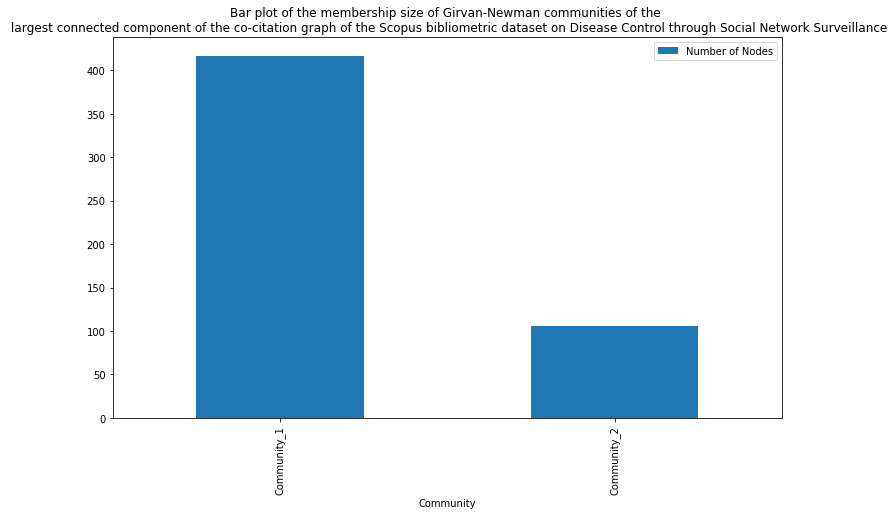

In [24]:
communities_generator = community.girvan_newman(Glcc)
communities = next(communities_generator)

# Sort the communities based on size 
groups = []
for c in communities: 
    size = len(c)
    groups.append([size, list(c)])
groups.sort(reverse=True)
print("The %s graph has %i Girvan-Newman communities" %(st3,len(groups)))

# Give each node a community id to which it belongs 
# Groups with a lower 'group_id' will be a member of a larger group
commsd={}
group_id = 1
for group in groups:
    members = group[1]
    for n in members: 
        Glcc.nodes[n]['community'] = group_id
    group_id += 1
    commsd["Community_"+str(group_id-1)]=group[0]
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
sst="Bar plot of the membership size of Girvan-Newman communities of the \n %s" %st3
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(12,7),rot=90,title=sst);

### 2e. Interactive visualization of the largest connected component of the co-citation graph

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
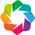

In [25]:
hv.extension('bokeh')
kwargs = dict(width=1000, height=1000, xaxis=None, yaxis=None)
hv.opts.defaults(hv.opts.Nodes(**kwargs), hv.opts.Graph(**kwargs)) 

# Choose a NetworkX graphical layout 
pos = graphviz_layout(Glcc) 
# Collect graph from NetworkX 
my_graph = hv.Graph.from_networkx(Glcc, pos)
# Bundle edges 
bundled = bundle_graph(my_graph)
bundled.opts(padding=0.1) 
# Add community and degree features
bundled.opts(node_color=hv.dim('community'), node_size=((hv.dim('degree') + 50)*0.1), width=1000, cmap='Colorblind')
bundled.opts(inspection_policy='edges')

# Save the visualization as html
hv.save(bundled, 'LCC_CoCitationGraph.html', backend='bokeh')

from bokeh.plotting import show 
show(hv.render(bundled))

## 3. The Network of Bibliographic Coupling

In [26]:
G2=G.copy()
medgesin=[]
n_in=[n for n in G2.nodes() if G2.in_degree(n)>1]
for n in n_in:
    nn=list(G2.predecessors(n))
    combs=combinations(nn, 2)
    for j in combs:
        medgesin.append((j[0],j[1]))
Gbc=nx.MultiGraph()
Gbc.add_edges_from(medgesin)
weight=[(x, y, {'weight': v}) for (x, y), v in Counter(Gbc.edges()).items()]
Gbc = nx.Graph(weight)
edge_width=[Gbc[u][v]['weight'] for u,v in Gbc.edges()]

st4="network of bibliographic coupling of the %s" %st
g_diagnostics(Gbc,st4)

The network of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance has 391 nodes and 1816 edges 

The network of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is an undirected graph
The network of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a simple graph
The network of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a weighted graph
The network of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not a bipartite graph
The network of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not a tree 

The network of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through

### 3a. Communities of the network of bibliographic coupling

In [27]:
for n in Gbc.nodes:
    Gbc.nodes[n]['label'] = type_dict[n]
    Gbc.nodes[n]['degree'] = Gbc.degree(n)

The network of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance graph has 33 Girvan-Newman communities


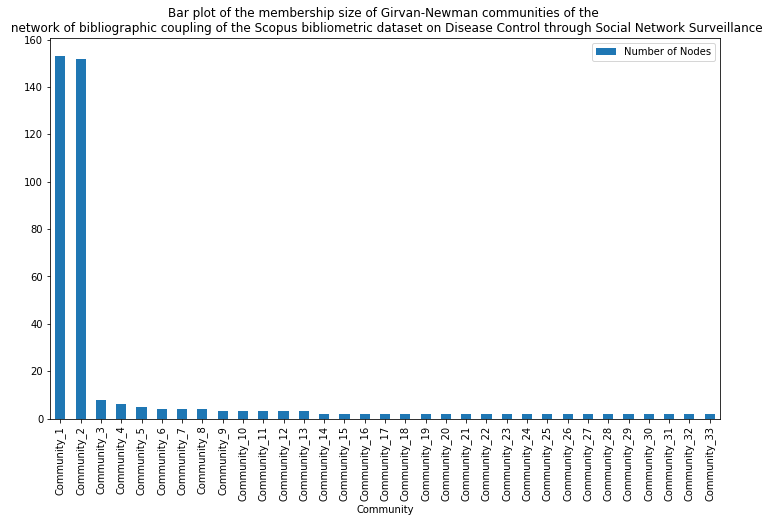

In [28]:
communities_generator = community.girvan_newman(Gbc)
communities = next(communities_generator)

# Sort the communities based on size 
groups = []
for c in communities: 
    size = len(c)
    groups.append([size, list(c)])
groups.sort(reverse=True)
print("The %s graph has %i Girvan-Newman communities" %(st4,len(groups)))

# Give each node a community id to which it belongs 
# Groups with a lower 'group_id' will be a member of a larger group
commsd={}
group_id = 1
for group in groups:
    members = group[1]
    for n in members: 
        Gbc.nodes[n]['community'] = group_id
    group_id += 1
    commsd["Community_"+str(group_id-1)]=group[0]
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
sst="Bar plot of the membership size of Girvan-Newman communities of the \n %s" %st4
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(12,7),rot=90,title=sst);

### 3b. Interactive visualization of the network of bibliographic coupling

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
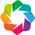

In [29]:
hv.extension('bokeh')
kwargs = dict(width=1000, height=1000, xaxis=None, yaxis=None)
hv.opts.defaults(hv.opts.Nodes(**kwargs), hv.opts.Graph(**kwargs)) 

# Choose a NetworkX graphical layout 
pos = graphviz_layout(Gbc) 
# Collect graph from NetworkX 
my_graph = hv.Graph.from_networkx(Gbc, pos)
# Bundle edges 
bundled = bundle_graph(my_graph)
bundled.opts(padding=0.1) 
# Add community and degree features
bundled.opts(node_color=hv.dim('community'), node_size=((hv.dim('degree') + 50)*0.1), width=1000, cmap='Colorblind')
bundled.opts(inspection_policy='edges')

# Save the visualization as html
hv.save(bundled, 'BCGraph.html', backend='bokeh')

from bokeh.plotting import show 
show(hv.render(bundled))

### 3c. The largest connected component of the graph of bibliographic coupling

In [31]:
st5="largest connected component of the graph of bibliographic coupling of the %s" %st
giant = max(nx.connected_components(Glcc), key=len)
Gbclcc=Glcc.subgraph(giant)
g_diagnostics(Gbclcc,st5)

The largest connected component of the graph of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance has 523 nodes and 7386 edges 

The largest connected component of the graph of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is an undirected graph
The largest connected component of the graph of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a simple graph
The largest connected component of the graph of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is a weighted graph
The largest connected component of the graph of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance is not a bipartite graph
The largest connected component of the graph of bibliographic coupling of the 

### 3d. Communities of the largest connected component of the graph of bibliographic coupling

In [32]:
for n in Gbclcc.nodes:
    Gbclcc.nodes[n]['label'] = type_dict[n]
    Gbclcc.nodes[n]['degree'] = Gbclcc.degree(n)

The largest connected component of the graph of bibliographic coupling of the Scopus bibliometric dataset on Disease Control through Social Network Surveillance graph has 2 Girvan-Newman communities


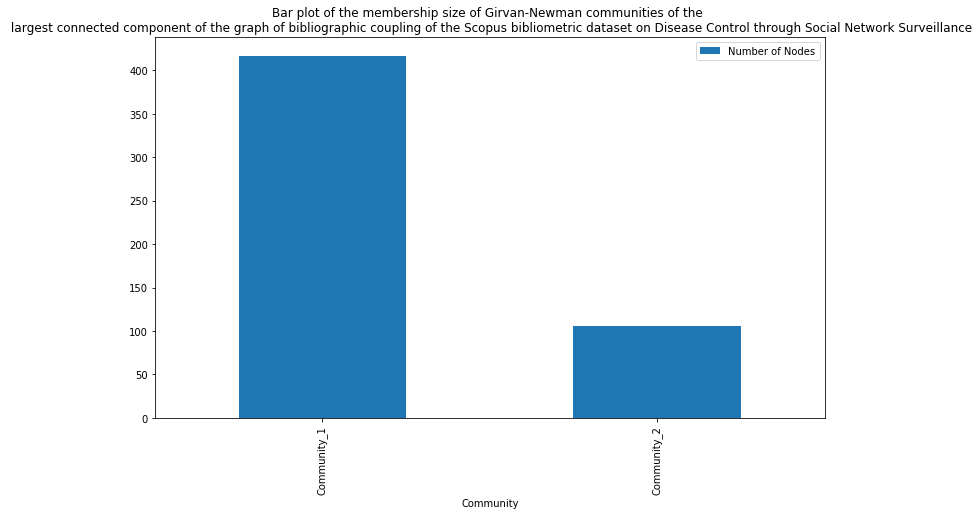

In [33]:
communities_generator = community.girvan_newman(Gbclcc)
communities = next(communities_generator)

# Sort the communities based on size 
groups = []
for c in communities: 
    size = len(c)
    groups.append([size, list(c)])
groups.sort(reverse=True)
print("The %s graph has %i Girvan-Newman communities" %(st5,len(groups)))

# Give each node a community id to which it belongs 
# Groups with a lower 'group_id' will be a member of a larger group
commsd={}
group_id = 1
for group in groups:
    members = group[1]
    for n in members: 
        Gbclcc.nodes[n]['community'] = group_id
    group_id += 1
    commsd["Community_"+str(group_id-1)]=group[0]
    
ddf=pd.DataFrame(commsd.items(), columns=['Community', 'Number of Nodes'])
sst="Bar plot of the membership size of Girvan-Newman communities of the \n %s" %st5
ddf.plot.bar(x='Community', y='Number of Nodes', figsize=(12,7),rot=90,title=sst);

### 3e. Interactive visualization of the largest connected component of the graph of bibliographic coupling

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
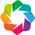

In [34]:
hv.extension('bokeh')
kwargs = dict(width=1000, height=1000, xaxis=None, yaxis=None)
hv.opts.defaults(hv.opts.Nodes(**kwargs), hv.opts.Graph(**kwargs)) 

# Choose a NetworkX graphical layout 
pos = graphviz_layout(Gbclcc) 
# Collect graph from NetworkX 
my_graph = hv.Graph.from_networkx(Gbclcc, pos)
# Bundle edges 
bundled = bundle_graph(my_graph)
bundled.opts(padding=0.1) 
# Add community and degree features
bundled.opts(node_color=hv.dim('community'), node_size=((hv.dim('degree') + 50)*0.1), width=1000, cmap='Colorblind')
bundled.opts(inspection_policy='edges')

# Save the visualization as html
hv.save(bundled, 'LCC_BCGraph.html', backend='bokeh')

from bokeh.plotting import show 
show(hv.render(bundled))